# 1. Define the Question 

We have been hired by Hass Consulting as a Data Scientist and tasked to accomplish the task: 

 - Study the factors that affect housing prices 
 - Create a model that would allow the company to accurately predict the sale of prices upon being provided with the predictor variables

### a. Question.  

 Hass Consulting Company is a real estate leader with over 25 years of experience. The company seeks wants :
 - A model that would allow the company to accurately predict the sale of prices upon being provided with the predictor variables.

Some of the predictor variables include:
- Number of bedrooms 
- Number of bathrooms
- Square footage of the house
- Square footage of the lot
- Square footage of the basement

- Number of floors
- Prescence of a waterfront, 
- The condition of the house
- Year built
- Year Renovated

### b. Metrics for success

The analysis will be considered complete and successful when:

- Define the question, the metric for success, the context, experimental design taken.
- Perform EDA
- Define the appropriateness of the available data to answer the given question.
- Find and deal with outliers, anomalies, and missing data within the dataset.
- Perform any necessary feature engineering
- Check of multicollinearity
- Figure out what factors affect the price ofa property
- Start building the model
- Build several models 
- Perform a K-fold to see the model that works best 

### c Understanding the context. 


Hass Consulting Company is a real estate leader with over 25 years of experience. 




... add content

### d. d) Recording the Experimental Design
The following steps will be followed in conducting this analysis:

- Defining the Question
- Reading the Data.
- Checking the Data.
- Data Cleaning
- Merging the Dataframes
- Performing EDA
- Prediction Models
- Evaluation of the solution
- Challenging the solution
- Conclusion

# Load datasets

In [1]:
# Importing all the required libraries. 

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas_profiling 
%matplotlib inline


In [2]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip


In [3]:
# load the data from the url provided
url = 'http://bit.ly/IndependentProjectWeek7Dataset'
house = pd.read_csv(url)
house.shape

(21613, 20)

In [4]:

print(house.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   price          21613 non-null  float64
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
 18  sqft_l

### Preview the datasets. 

In [5]:
# First five records
house.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [6]:
# Last five records
house.tail()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
21608,263000018,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287
21612,1523300157,325000.0,2,0.75,1020,1076,2.0,0,0,3,7,1020,0,2008,0,98144,47.5941,-122.299,1020,1357


## Checking the datasets 

In [7]:
house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   price          21613 non-null  float64
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
 18  sqft_l

In [8]:
house.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.401822e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.673622e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


# Cleaning the data

In [9]:
# check for missing values
house.isna().sum()

id               0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

The dataset does not have any missing values

In [10]:
# Check for duplicated data
house.duplicated().sum()

3

The dataset has 3 duplicated records. We should deal with that.

In [11]:
house.drop_duplicates(inplace=True)

In [12]:
# Uniformity. 
house.columns

Index(['id', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15'],
      dtype='object')

The data follows a uniform naming convention. 

In [13]:
#check for the data types
house.dtypes

id                 int64
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

In [14]:
house.yr_built = pd.to_datetime(house.yr_built, format = '%Y')
house.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955-01-01,0,98178,47.5112,-122.257,1340,5650
1,6414100192,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951-01-01,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933-01-01,0,98028,47.7379,-122.233,2720,8062
3,2487200875,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965-01-01,0,98136,47.5208,-122.393,1360,5000
4,1954400510,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987-01-01,0,98074,47.6168,-122.045,1800,7503


TypeError: ignored

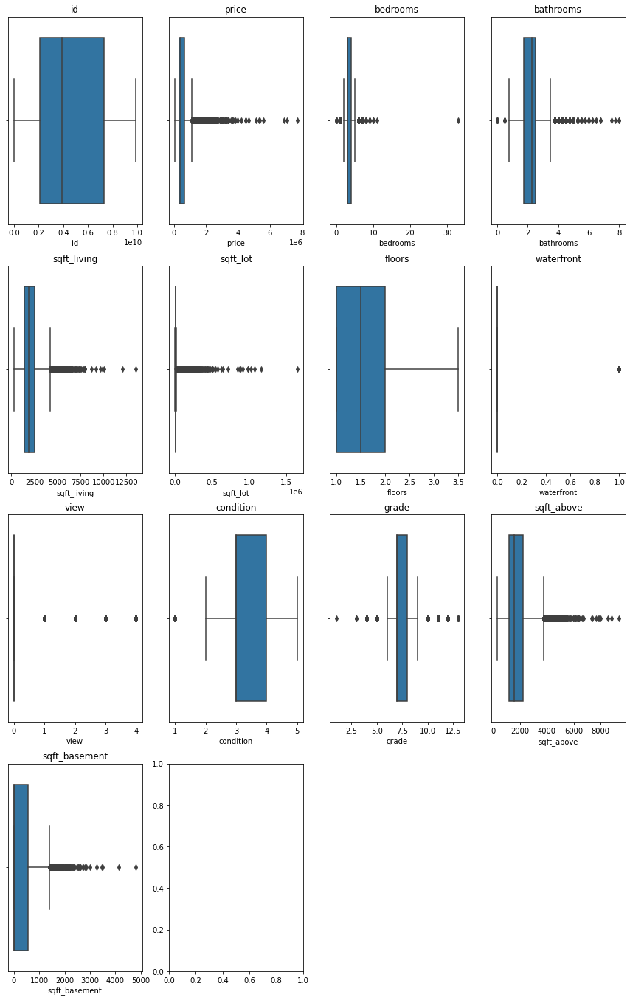

In [16]:
# Checking for Outliers
import warnings
warnings.filterwarnings("ignore")

# Checking for Outliers
 
# we save the column names onto a dictionary
boxplot_ls = {'id': 1, 'price': 2, 'bedrooms': 3, 'bathrooms': 4, 'sqft_living': 5, 'sqft_lot': 6,
       'floors': 7, 'waterfront': 8, 'view': 9, 'condition': 10, 'grade': 11, 'sqft_above': 12,
       'sqft_basement': 13, 'yr_built': 14, 'yr_renovated':15, 'zipcode': 16, 'lat': 17, 'long': 18,
       'sqft_living15': 19, 'sqft_lot15': 20}

plt.figure(figsize=(15,30))

# we make a boxplot for each numerical column
for a,i in boxplot_ls.items():
  plt.subplot(5,4,i)
  sns.boxplot(house[a])
  plt.title(a)

plt.show()

There boxplot visualization shows several outliers but i feel it would be unwise to eliminate the outliers as they are not unreasonable. 

In [17]:
house.yr_built.unique()

array(['1955-01-01T00:00:00.000000000', '1951-01-01T00:00:00.000000000',
       '1933-01-01T00:00:00.000000000', '1965-01-01T00:00:00.000000000',
       '1987-01-01T00:00:00.000000000', '2001-01-01T00:00:00.000000000',
       '1995-01-01T00:00:00.000000000', '1963-01-01T00:00:00.000000000',
       '1960-01-01T00:00:00.000000000', '2003-01-01T00:00:00.000000000',
       '1942-01-01T00:00:00.000000000', '1927-01-01T00:00:00.000000000',
       '1977-01-01T00:00:00.000000000', '1900-01-01T00:00:00.000000000',
       '1979-01-01T00:00:00.000000000', '1994-01-01T00:00:00.000000000',
       '1916-01-01T00:00:00.000000000', '1921-01-01T00:00:00.000000000',
       '1969-01-01T00:00:00.000000000', '1947-01-01T00:00:00.000000000',
       '1968-01-01T00:00:00.000000000', '1985-01-01T00:00:00.000000000',
       '1941-01-01T00:00:00.000000000', '1915-01-01T00:00:00.000000000',
       '1909-01-01T00:00:00.000000000', '1948-01-01T00:00:00.000000000',
       '2005-01-01T00:00:00.000000000', '1929-01-01

# 5. Analysis of the data

### Univariate analysis


For the Univariate analysis, the pandas profiling tool is the best to automate the process and also provide useful infomation. 

In [18]:
from pandas_profiling import ProfileReport

profile = ProfileReport(house, title="House Data", html={'style':{'full_width':True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

From the report we can infer:
- strong correlation between price and a number of other factors.
- The profile also displays the measures of dispersion of the numerical columns

In [19]:
profile.to_file(output_file="House Data.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
# the next step would be dropping the uneccesary variables in the prediction of price. 
unecessary_columns = ['id', 'sqft_above', 'sqft_basement','lat', 'long', 'sqft_living15', 'sqft_lot15']
house.drop(unecessary_columns, 1, inplace=True)

I chose to drop the columns such as lat and long because they were for location which could be infered from the zipcode column.

The sqft_above and sqft_below  were dropped because they had many values at zero meaning they are not such good predictors 

### Bivariate Analysis

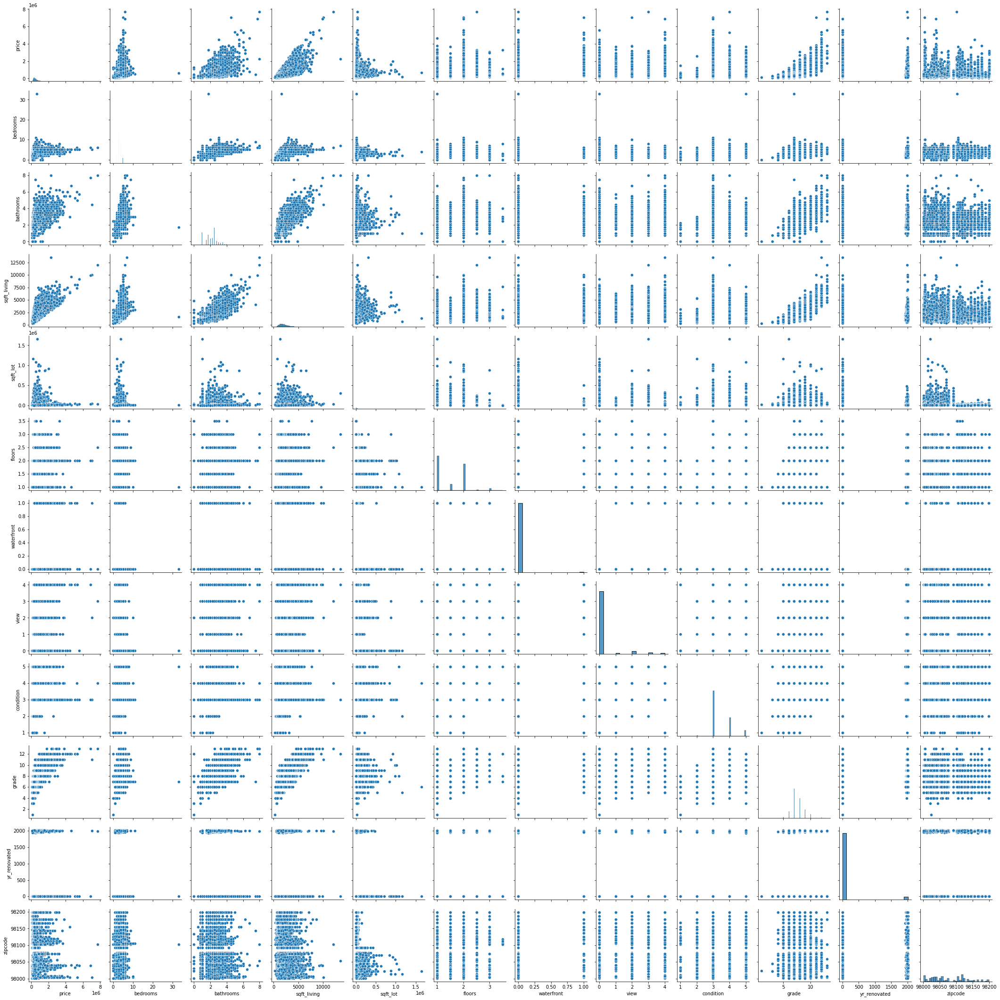

In [21]:
sns.pairplot(house)

In [22]:
# The next part is using a pearsons_r corelation heatmap. 
corr = house.corr()
corr

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,yr_renovated,zipcode
price,1.000000,0.308346,0.525140,0.702046,0.089658,0.256793,0.266332,0.397466,0.036397,0.667478,0.126503,-0.053162
bedrooms,0.308346,1.000000,0.515935,0.576674,0.031699,0.175448,-0.006583,0.079433,0.028422,0.357003,0.018695,-0.152721
bathrooms,0.525140,0.515935,1.000000,0.754688,0.087750,0.500669,0.063747,0.187891,-0.124940,0.664990,0.050879,-0.203831
sqft_living,0.702046,0.576674,0.754688,1.000000,0.172830,0.353954,0.103820,0.284641,-0.058768,0.762719,0.055314,-0.199435
sqft_lot,0.089658,0.031699,0.087750,0.172830,1.000000,-0.005171,0.021601,0.074753,-0.008967,0.113644,0.007677,-0.129611
floors,0.256793,0.175448,0.500669,0.353954,-0.005171,1.000000,0.023711,0.029325,-0.263779,0.458151,0.006156,-0.059025
waterfront,0.266332,-0.006583,0.063747,0.103820,0.021601,0.023711,1.000000,0.401993,0.016652,0.082785,0.092950,0.030277
view,0.397466,0.079433,0.187891,0.284641,0.074753,0.029325,0.401993,1.000000,0.045836,0.251378,0.103208,0.084838
condition,0.036397,0.028422,-0.124940,-0.058768,-0.008967,-0.263779,0.016652,0.045836,1.000000,-0.144655,-0.060862,0.002962
grade,0.667478,0.357003,0.664990,0.762719,0.113644,0.458151,0.082785,0.251378,-0.144655,1.000000,0.014372,-0.184795


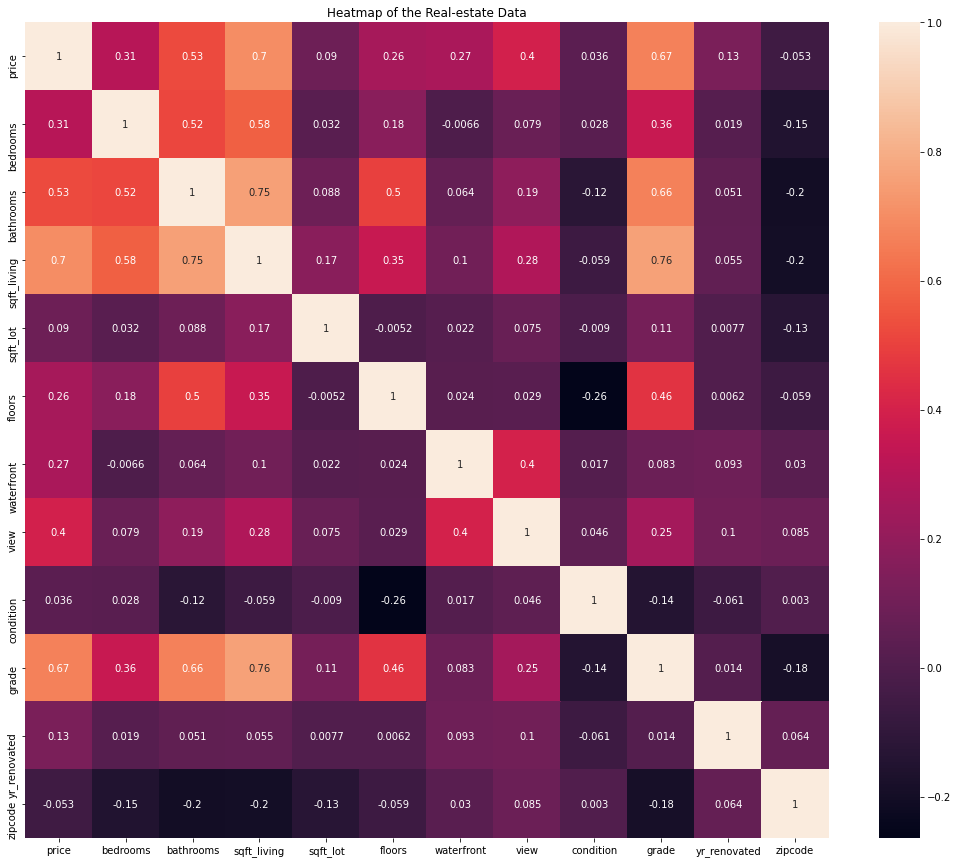

In [23]:
#To get a good visualization we can use a heat map to see the corelation between the data
plt.figure(figsize = (18, 15))
plt.title('Heatmap of the Real-estate Data')
sns.heatmap(corr, annot=True)

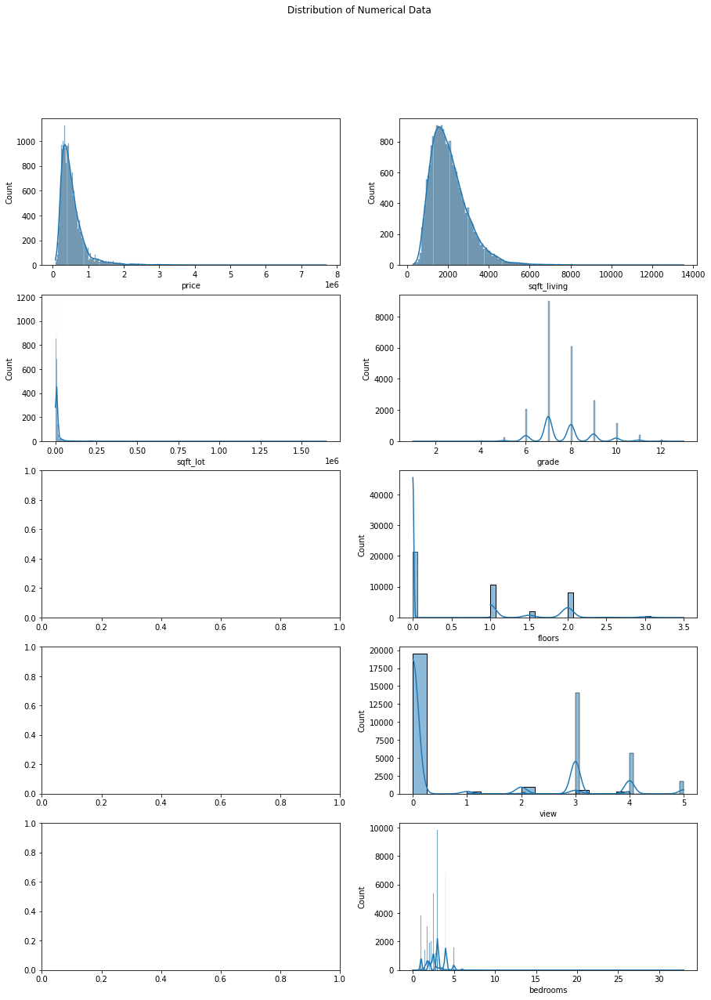

In [24]:
# We should check the didtribution of the data.
# Using the seaborn distplot 

fig, axes = plt.subplots(5, 2,  figsize=(15, 20))

fig.suptitle('Distribution of Numerical Data')

sns.histplot( house["price"] , ax=axes[0, 0], kde= True)
sns.histplot( house['sqft_living'] , ax=axes[0, 1], kde= True)
sns.histplot( house["sqft_lot"] , ax=axes[1, 0], kde= True)
sns.histplot( house['grade'] , ax=axes[1, 1], kde= True)
sns.histplot( house['floors'] , ax=axes[2, 1], kde= True)
sns.histplot( house['waterfront'] , ax=axes[2, 1], kde= True)
sns.histplot( house['view'] , ax=axes[3, 1], kde= True)
sns.histplot( house['condition'] , ax=axes[3, 1], kde= True)
sns.histplot( house['bedrooms'] , ax=axes[4, 1], kde= True)
sns.histplot( house['bathrooms'] , ax=axes[4, 1], kde= True)




The visualization enables us to infer the distribution of the difffernt columns. 

Text(0.5, 1.0, 'Price Vs Year built')

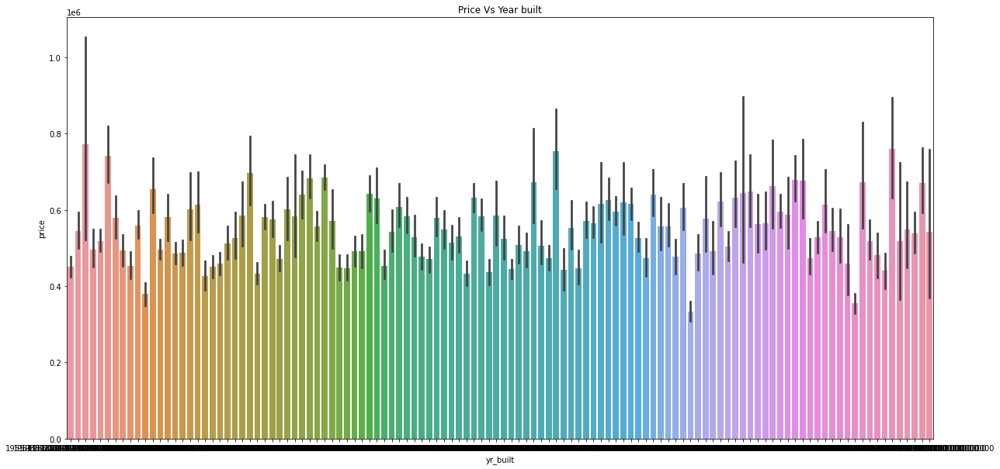

In [25]:
# Price vs Yr_built 
y = house['price']
x = house['yr_built']

plt.figure(figsize = (20,10))
sns.barplot(x, y)
plt.title('Price Vs Year built')


Text(0.5, 1.0, 'Price Vs Grade')

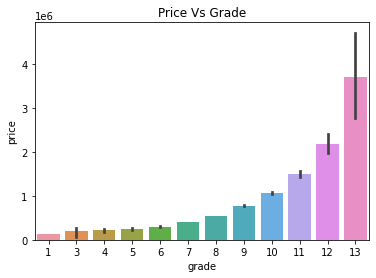

In [26]:
# price vs Grade
x = house['price']
y = house['grade']
sns.barplot(y, x)
plt.title('Price Vs Grade')


Text(0.5, 1.0, 'Price Vs Bedrooms')

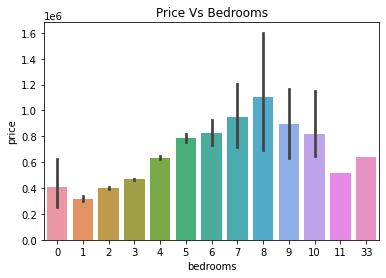

In [27]:
# price vs bedrooms
x = house['price']
y = house['bedrooms']
sns.barplot(y, x)
plt.title('Price Vs Bedrooms')


Text(0.5, 1.0, 'Price Vs Floors')

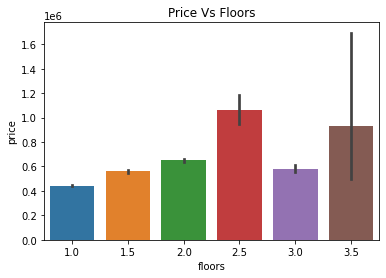

In [28]:
# Price vs floors
x = house['price']
y = house['floors']
sns.barplot(y, x)
plt.title('Price Vs Floors')


Text(0.5, 1.0, 'Price Vs Living square footage')

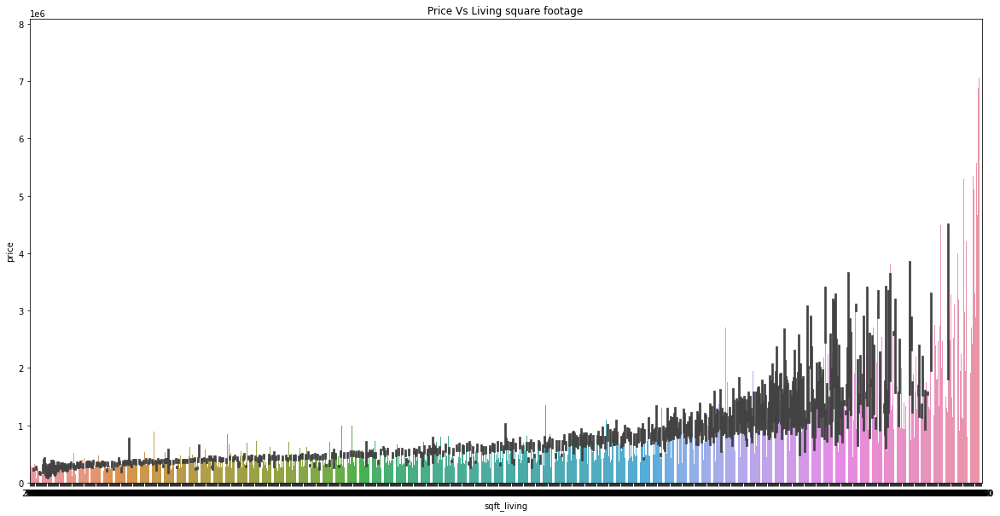

In [29]:
# price vs sqft_living
x = house['price']
y = house['sqft_living']
plt.figure(figsize = (20,10))

sns.barplot(y, x)
plt.title('Price Vs Living square footage')


It can be infered that as the Squarefootage ingreases so does the price except in a few outliers where the price is abut higher for their square footage. 

Text(0.5, 1.0, 'Price Vs View')

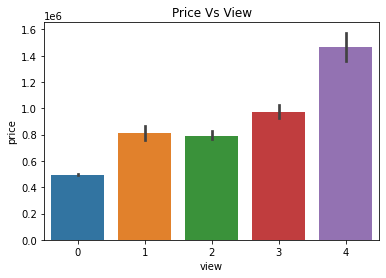

In [30]:
# Price vs Views
x = house['price']
y = house['view']

sns.barplot(y, x)
plt.title('Price Vs View')


Text(0.5, 1.0, 'Price Vs Waterfront')

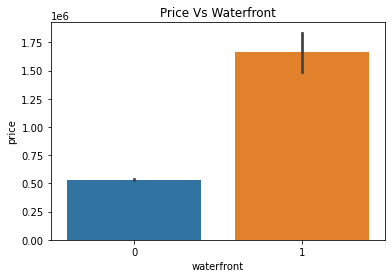

In [31]:
# Price vs Waterfront
x = house['price']
y = house['waterfront']
sns.barplot(y, x)
plt.title('Price Vs Waterfront')


The houses with a water front are more expensive than those without. 

Text(0.5, 1.0, 'Price Vs Year renovated')

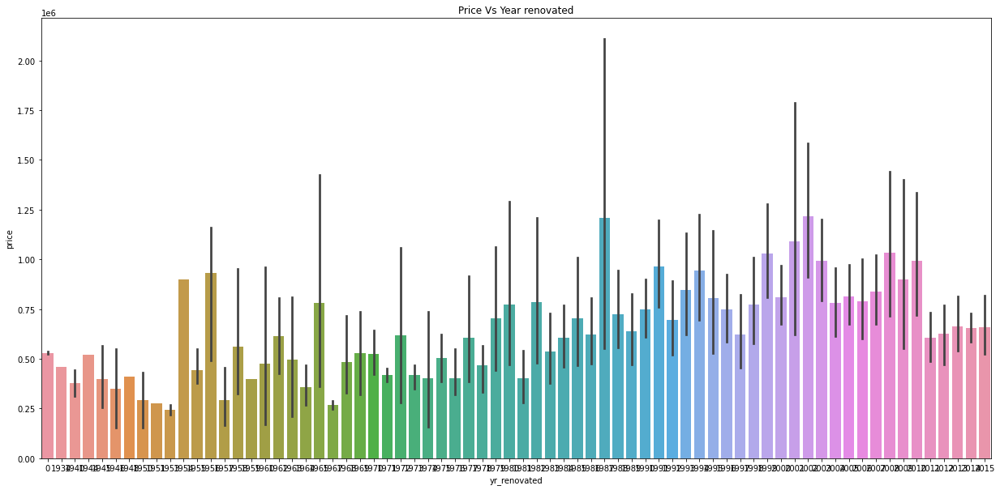

In [32]:
# Price vs Waterfront
x = house['price']
y = house['yr_renovated']
plt.figure(figsize =(21,10) ) 
sns.barplot(y, x)
plt.title('Price Vs Year renovated')


Text(0.5, 1.0, 'Price Vs Condition')

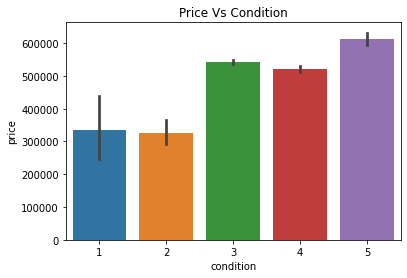

In [33]:
# Price vs condition
x = house['price']
y = house['condition']
sns.barplot(y, x)
plt.title('Price Vs Condition')


Text(0.5, 1.0, 'Price vs Zipcode')

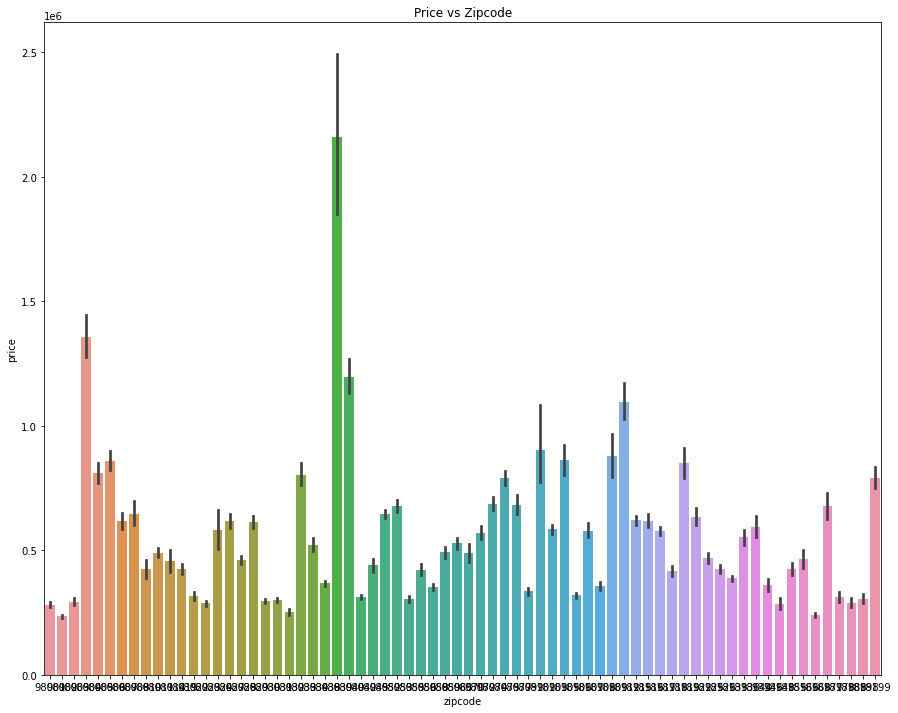

In [34]:
# Price vs Zipcode
x = house['price']
y = house['zipcode']
plt.figure(figsize = (15,12))
sns.barplot(y, x)
plt.title('Price vs Zipcode')

## Multivariate analysis

We will use the LDA to predict what variables. 

In [35]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

#preprocessing.

X = house.drop(['price', 'yr_built'], axis = 1)
y = house.price

# divide into train and test data
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.2, random_state = 0)

# feature scaling
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

#create an instance of LDA
lda = LDA()
X_train = lda.fit_transform(X_train, y_train)
X_test = lda.transform(X_test)
lda_ = lda.fit(X_train, y_train)

In [36]:
# Creating a coefficient dataframe
coefdf =pd.DataFrame(index=X.columns.values,data=lda_.coef_[0].T)
coefdf .sort_values(0,ascending=False)

,0
bathrooms,3.284198
grade,1.521914
waterfront,1.118836
condition,0.643537
yr_renovated,0.084005
view,-0.668098
floors,-0.986913
zipcode,-1.161629
sqft_lot,-1.207167
sqft_living,-3.467374


From the dimension reductionality excersie we can see that the columns above have the best prediction statistics for construction of our models. 

# 6.  Logistic regression. 

The prediction required in the code is for the price of the house. 
The following models will be trained and tested. 

#### Mutlicolinearity 

In [37]:
pd.DataFrame(np.linalg.inv(corr.values), index = corr.index, columns=corr.columns)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,yr_renovated,zipcode
price,2.597112,0.211412,0.048628,-1.267743,0.081722,0.057850,-0.344089,-0.299892,-0.271384,-0.874332,-0.195845,-0.170856
bedrooms,0.211412,1.654847,-0.413193,-1.084980,0.116729,0.086018,0.035808,0.076405,-0.109433,0.285145,-0.001920,0.029146
bathrooms,0.048628,-0.413193,2.888124,-1.408366,0.060639,-0.690497,0.004406,-0.027419,0.048467,-0.379657,-0.062537,0.150314
sqft_living,-1.267743,-1.084980,-1.408366,4.708081,-0.351807,0.222608,0.113190,-0.168428,0.034079,-1.420467,0.013965,0.133700
sqft_lot,0.081722,0.116729,0.060639,-0.351807,1.061165,0.060743,0.002556,-0.049046,0.010208,0.017991,-0.006775,0.113308
floors,0.057850,0.086018,-0.690497,0.222608,0.060743,1.519950,-0.043250,0.121282,0.249695,-0.489905,0.023238,-0.084296
waterfront,-0.344089,0.035808,0.004406,0.113190,0.002556,-0.043250,1.246420,-0.442220,0.028692,0.167471,-0.036923,0.041446
view,-0.299892,0.076405,-0.027419,-0.168428,-0.049046,0.121282,-0.442220,1.383313,-0.042424,-0.076120,-0.046155,-0.157589
condition,-0.271384,-0.109433,0.048467,0.034079,0.010208,0.249695,0.028692,-0.042424,1.126404,0.222956,0.095151,0.036065
grade,-0.874332,0.285145,-0.379657,-1.420467,0.017991,-0.489905,0.167471,-0.076120,0.222956,3.107668,0.155983,0.174770


The multicollinearity are below 5 . Therefore, that means that the correlation index is negligable. Therefore, we can proceed with the prediction analysis.

In [39]:
# First let us create a copy of the house dataframe and then proceed
copy = house
copy.head(5)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,yr_built,yr_renovated,zipcode
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1955-01-01,0,98178
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,1951-01-01,1991,98125
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,1933-01-01,0,98028
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1965-01-01,0,98136
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1987-01-01,0,98074


In [ ]:
copy.drop(['sqft_above', 'sqft_basement'], 1, inplace=True)

In [41]:
# Importing all the neccesary libraries. 
# Some of the libraries include the sklearn and the scipy
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import PolynomialFeatures
from sklearn import metrics

We begin with quantile regression 

### a)Quantaile regresion 

In [42]:
#features and label
X = copy.drop(['price', 'yr_built'], 1)
y = copy['price']

#splitting dataset
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [43]:
# standard scaler. Scaling the X_Train and X_test 
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [44]:
import statsmodels.formula.api as smf
from statsmodels.regression.quantile_regression import QuantReg
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, KFold
import scipy as sp

In [ ]:
X

In [46]:
# On the 50th percentile. 
mod = smf.quantreg(('y ~ view + condition + grade  + yr_renovated + zipcode + sqft_living + sqft_lot + yr_renovated'), copy)
res = mod.fit(q=.5)
print(res.summary())

                         QuantReg Regression Results                          
Dep. Variable:                      y   Pseudo R-squared:               0.3364
Model:                       QuantReg   Bandwidth:                   2.716e+04
Method:                 Least Squares   Sparsity:                    3.849e+05
Date:                Sat, 24 Jul 2021   No. Observations:                21610
Time:                        12:16:33   Df Residuals:                    21602
                                        Df Model:                            7
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept        2.8155      0.236     11.934      0.000       2.353       3.278
view          7.233e+04   1799.580     40.191      0.000    6.88e+04    7.59e+04
condition     4.763e+04   2050.568     23.228      0.000    4.36e+04    5.16e+04
grade         9.646e+04   1750.095     55.

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)


In [47]:
# On the 25th percentile. 
mod = smf.quantreg(('y ~ view + condition + grade  + yr_renovated + zipcode + sqft_living + sqft_lot + yr_renovated'), copy)
res = mod.fit(q=.25)
print(res.summary())

                         QuantReg Regression Results                          
Dep. Variable:                      y   Pseudo R-squared:               0.2657
Model:                       QuantReg   Bandwidth:                   2.416e+04
Method:                 Least Squares   Sparsity:                    4.255e+05
Date:                Sat, 24 Jul 2021   No. Observations:                21610
Time:                        12:16:36   Df Residuals:                    21602
                                        Df Model:                            7
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept      -10.1434      0.223    -45.466      0.000     -10.581      -9.706
view          4.903e+04   1714.059     28.606      0.000    4.57e+04    5.24e+04
condition     2.266e+04   1888.484     12.000      0.000     1.9e+04    2.64e+04
grade          8.75e+04   1568.327     55.

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)


In [48]:
# On the 75th percentile. 
mod = smf.quantreg(('y ~ view + condition + grade  + yr_renovated + zipcode + sqft_living + sqft_lot + yr_renovated'), copy)
res = mod.fit(q=.75)
print(res.summary())

                         QuantReg Regression Results                          
Dep. Variable:                      y   Pseudo R-squared:               0.3967
Model:                       QuantReg   Bandwidth:                   2.451e+04
Method:                 Least Squares   Sparsity:                    5.260e+05
Date:                Sat, 24 Jul 2021   No. Observations:                21610
Time:                        12:16:41   Df Residuals:                    21602
                                        Df Model:                            7
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
Intercept      -21.5832      0.285    -75.798      0.000     -22.141     -21.025
view          1.039e+05   2132.784     48.703      0.000    9.97e+04    1.08e+05
condition     5.649e+04   2568.573     21.993      0.000    5.15e+04    6.15e+04
grade         9.363e+04   2182.278     42.

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)


In [49]:
quantiles = np.arange(0.1,1,0.1) 
models = []
params = []

# We build models for each quantile in our list quantiles inside a for loop
# As we build these models we also store the model parameters in a list called params. 
for qt in quantiles: 
	res = mod.fit(q = qt )
	models.append(res)
	params.append([qt, res.params['Intercept'], res.params['view']] + res.conf_int().loc['view'].tolist())
	params.append([qt, res.params['Intercept'], res.params['condition']] + res.conf_int().loc['condition'].tolist())
	params.append([qt, res.params['Intercept'], res.params['grade']] + res.conf_int().loc['grade'].tolist())
	params.append([qt, res.params['Intercept'], res.params['yr_renovated']] + res.conf_int().loc['yr_renovated'].tolist())
	params.append([qt, res.params['Intercept'], res.params['zipcode']] + res.conf_int().loc['zipcode'].tolist())

 

# Lastly we make a dataframe of the same name, so we we can view our different models.
params = pd.DataFrame(data = params, columns = ['qt', 'intercept', 'x_coef', 'cf_lower_bound', 'cf_upper_bound'])
print(params)

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)
/usr/local/lib/

     qt  intercept         x_coef  cf_lower_bound  cf_upper_bound
0   0.1   6.078356   26001.488003    23738.490180    28264.485825
1   0.1   6.078356   12824.332466    10109.098014    15539.566919
2   0.1   6.078356   46751.562151    44493.684976    49009.439326
3   0.1   6.078356      28.179324       23.536339       32.822309
4   0.1   6.078356      -2.705885       -2.880536       -2.531235
5   0.2 -19.979138   51379.352298    48151.944156    54606.760440
6   0.2 -19.979138   19319.057192    15923.879261    22714.235122
7   0.2 -19.979138   79424.141727    76627.073165    82221.210289
8   0.2 -19.979138      42.875216       37.010148       48.740283
9   0.2 -19.979138      -4.966724       -5.181785       -4.751663
10  0.3  -1.832387   50000.662177    46555.460254    53445.864101
11  0.3  -1.832387   31975.550024    28118.101579    35832.998470
12  0.3  -1.832387   88225.298894    85018.152117    91432.445671
13  0.3  -1.832387      45.926910       39.518431       52.335390
14  0.3  -

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/quantile_regression.py:192: IterationLimitWarning: Maximum number of iterations (1000) reached.
  ") reached.", IterationLimitWarning)


In [50]:

qreg_model = QuantReg(y_train, X_train)

# Fit the linear quantile regression three times, for the interval
# boundaries and the median
preds = []
for q in [0.05, 0.5, 0.95]:
    res = qreg_model.fit(q)
    intercept, slope = res.params[0], res.params[1]
    preds.append(slope * X_test + intercept)

prediction_intervals = np.stack(preds, axis = 1)
prediction_intervals
print(intercept)


-12921.295797004284


### b)Ridge regression. 

In [51]:
# Establish a baseline 
# 
regression = LinearRegression()
regression.fit(X_train ,y_train)
first_model = (mean_squared_error(y_true=y,y_pred=regression.predict(X)))
print(first_model)


6.86057600943635e+18


In [52]:
# Initialize the ridge and gridsearch paramns
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge
ridge = Ridge(normalize=True)
search = GridSearchCV(estimator=ridge,param_grid={'alpha':np.logspace(-5,2,8)},scoring='neg_mean_squared_error',n_jobs=1,refit=True,cv=10)

In [53]:
# run the model using the fit function to get the best params
search.fit(X_train,y_train)
search.best_params_

{'alpha': 0.001}

In [54]:
# The best_params formilae suggested that we use X as 0.01
{'alpha': 0.001}
abs(search.best_score_) 

52774943312.95125

The best score found that 52774943312.95 is the best price with is lower  than that of the baseline regression (6.2016 e+18)

In [55]:
# We can confirm this by fitting our model with the ridge information and finding the mean squared error below
#
ridge = Ridge(normalize=True,alpha=0.01)
ridge.fit(X_train,y_train)
second_model = (mean_squared_error(y_true=y_test,y_pred=ridge.predict(X_test)))
print(second_model)

50257288353.04845


With the confirmation the value got a bit lower. 

In [56]:
# lets figure out the coeficients
coef_dict_baseline = {}
for coef, feat in zip(regression.coef_,copy.columns):
    coef_dict_baseline[feat] = coef
coef_dict_baseline

{'bathrooms': 179414.04138777126,
 'bedrooms': -5948.322943940235,
 'condition': 122847.41805916687,
 'floors': 52833.606589969386,
 'grade': 27870.941086663188,
 'price': -30685.35527322079,
 'sqft_living': -11558.79836027684,
 'sqft_lot': -9165.64642392001,
 'view': 38803.37565799953,
 'waterfront': 42744.37293335243,
 'yr_built': 24197.852558697534}

There is little difference in the coefficients. 

### Lasso regression. 

In [57]:
from sklearn import linear_model
from sklearn.metrics import mean_squared_error

# Creating lasso object
# 
lasso = linear_model.Lasso() 

# Fitting the models
# 
lasso.fit(X_train, y_train) 

# Print scores, MSE, and coefficients
# 
print("lasso score:", lasso.score(X_train, y_train)) 
print("lasso MSE:", mean_squared_error(y_test, lasso.predict(X_test))) 
print("lasso coef:", lasso.coef_) 

lasso score: 0.6140564206672077
lasso MSE: 50268088919.097015
lasso coef: [-30683.57278045  -5944.94221873 179410.10850045 -11557.33978348
  -9164.728083    52833.00843536  42744.46166674  38802.44693478
 122845.6928957   27869.99423471  24197.01415621]


The lasso score has a 61% accuracy. using a linear regression model. 

In [58]:
import warnings
warnings.filterwarnings("ignore")


parameters = {'alpha': np.concatenate((np.arange(0.1,2,0.1), np.arange(2, 5, 0.5), np.arange(5, 25, 1)))}

linear = linear_model.LinearRegression()
lasso = linear_model.Lasso() 
gridlasso = GridSearchCV(lasso, parameters, scoring ='r2') 

# Fitting models and print the best parameters, R-squared scores, MSE, and coefficients
gridlasso.fit(X_train, y_train) 
linear.fit(X_train, y_train) 
print("lasso best parameters:", gridlasso.best_params_) 
print("lasso score:", gridlasso.score(X_test, y_test))
print("linear score:", linear.score(X_test, y_test)) 
print("lasso MSE:", mean_squared_error(y_test, gridlasso.predict(X_test)))
print("linear MSE:", mean_squared_error(y_test, linear.predict(X_test))) 
print("lasso best estimator coef:", gridlasso.best_estimator_.coef_)
print("linear coef:", linear.coef_)

lasso best parameters: {'alpha': 24.0}
lasso score: 0.6175109128620557
linear score: 0.6175005771373692
lasso MSE: 50266787782.02159
linear MSE: 50268146104.904144
lasso best estimator coef: [-30641.02596111  -5864.55045775 179315.10320641 -11523.58775304
  -9144.84817671  52819.38843413  42746.41494046  38781.19405956
 122807.77051105  27848.28428045  24177.87589437]
linear coef: [-30685.35527322  -5948.32294394 179414.04138777 -11558.79836028
  -9165.64642392  52833.60658997  42744.37293335  38803.375658
 122847.41805917  27870.94108666  24197.8525587 ]


The lasso score is a bit higher than the linear score in the prediction above. 

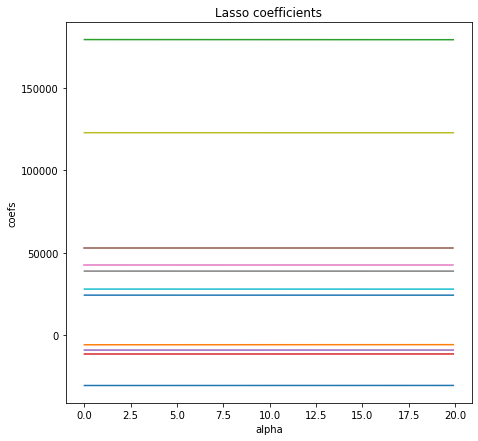

In [59]:
# Visualization of the lasso regression. 
coefsLasso = [] 

# Building Lasso for 200 values of alpha and write the coefficients into array
# 
alphasLasso = np.arange (0, 20, 0.1) 
for i in range(200):
    lasso = linear_model.Lasso(alpha=alphasLasso[i])
    lasso.fit(X_train, y_train)
    coefsLasso.append(lasso.coef_) 

# Building Lasso coefficient plots
# 
plt.figure(figsize = (16,7))

plt.subplot(121)
plt.plot(alphasLasso, coefsLasso)
plt.title('Lasso coefficients')
plt.xlabel('alpha')
plt.ylabel('coefs')

plt.show()

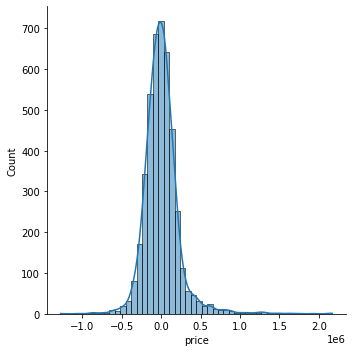

In [60]:
# lets check for residual plot for the prediction model. 
y_pred=ridge.predict(X_test)
sns.displot((y_test-y_pred), bins = 50, kde = True )
plt.show()

### d) Elastic net regression 

In [65]:
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 5000)
pd.set_option('display.max_columns', 5000)
pd.set_option('display.width', 10000)
from sklearn.linear_model import ElasticNet


In [62]:
# Creating Baseline
#
regression=LinearRegression()
regression.fit(X_train ,y_train)
first_model=(mean_squared_error(y_true=y_test,y_pred=regression.predict(X_test)))
print(first_model) 

50268146104.904144


In [63]:
# Below are the coefficients of this first model. We use a for loop to go through 
# the model and the zip function to combine the two columns.
# 
coef_dict_baseline = {}
for coef, feat in zip(regression.coef_,X.columns):
    coef_dict_baseline[feat] = coef
coef_dict_baseline

{'bathrooms': -5948.322943940235,
 'bedrooms': -30685.35527322079,
 'condition': 38803.37565799953,
 'floors': -9165.64642392001,
 'grade': 122847.41805916687,
 'sqft_living': 179414.04138777126,
 'sqft_lot': -11558.79836027684,
 'view': 42744.37293335243,
 'waterfront': 52833.606589969386,
 'yr_renovated': 27870.941086663188,
 'zipcode': 24197.852558697534}

In [66]:
# Intitialize Elastic net model. 
# The argument are set inside the ElasticNet function. 
# The second thing we need to do is create our grid.
# 
elastic=ElasticNet(normalize=True)
search=GridSearchCV(estimator=elastic,param_grid={'alpha':np.logspace(-5,2,8),'l1_ratio':[.2,.4,.6,.8]},scoring='neg_mean_squared_error',n_jobs=1,refit=True,cv=10)

In [67]:
# fit the model
# 
search.fit(X_train ,y_train)
search.best_params_

{'alpha': 1e-05, 'l1_ratio': 0.8}

The best paramns give us the Alpha as 1e-05, l1_train:0.8

In [68]:
abs(search.best_score_)

52834149320.86418

The best score is given and it is higher than the initial or baseline linear model

In [69]:
# The best hyperparameters was an alpha set to  1e-05, 'l1_ratio': 0.8. 
# With these settings we got an MSE of 1.08. This is above our baseline model of MSE 1.05  for the baseline model. 
# Which means that elastic net is doing worse than linear regression. 
# For clarity, we will set our hyperparameters to the recommended values and run on the data.
# 
elastic=ElasticNet(normalize=True,alpha=1e-05,l1_ratio=0.8)
elastic.fit(X_train,y_train)
second_model=(mean_squared_error(y_true=y_test,y_pred=elastic.predict(X_test)))
print(second_model)

50291601863.365265


The second model best score is a bit lower than the first model. Now we should check the coefficients for the model. 

In [70]:
# Below are the coefficients
# 
coef_dict_baseline = {}
for coef, feat in zip(elastic.coef_,X.columns):
    coef_dict_baseline[feat] = coef
coef_dict_baseline


{'bathrooms': 2524.440040727475,
 'bedrooms': -25404.76849920909,
 'condition': 37366.28855873662,
 'floors': -8498.732174200342,
 'grade': 121495.80315102822,
 'sqft_living': 164092.52539250808,
 'sqft_lot': -9552.041531092476,
 'view': 44423.92560867109,
 'waterfront': 51716.68856912219,
 'yr_renovated': 27158.957816243685,
 'zipcode': 22863.5228115486}

There is slight differences in the coeficients in the first model and the second model. 

### e) Multiple linear regression. 

In [71]:
# since the data is already split into testing and training sets lets just runnthe regression. 
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [72]:
# To see what coefficients our regression model has chosen, 
# 
coeff_df = pd.DataFrame(regressor.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
bedrooms,-30685.355273
bathrooms,-5948.322944
sqft_living,179414.041388
sqft_lot,-11558.798360
floors,-9165.646424
waterfront,52833.606590
view,42744.372933
condition,38803.375658
grade,122847.418059
yr_renovated,27870.941087


In [73]:
# To make pre-dictions on the test data, execute the following
# ---
# 
y_pred = regressor.predict(X_test)

# To compare the actual output values for X_test with the predicted values
# 
df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
df.describe()

,Actual,Predicted
count,4.322000e+03,4.322000e+03
mean,5.434344e+05,5.382671e+05
std,3.625612e+05,2.923442e+05
min,8.100000e+04,-5.669631e+05
25%,3.230000e+05,3.441403e+05
50%,4.500000e+05,4.698289e+05
75%,6.500000e+05,6.614634e+05
max,4.000000e+06,2.343953e+06


The prediction is not very accurate bu we need to fugure out the metrics

In [74]:
# 
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 149933.18721521363
Mean Squared Error: 50268146104.904144
Root Mean Squared Error: 224205.58892432664


The RMSE is quite high meaning that the model is not good for the data. 

In [75]:
residuals = np.subtract(y_pred, y_test)

# Let's describe our residual:
pd.DataFrame(residuals).describe()

residuals.mean()

-5167.250076185725

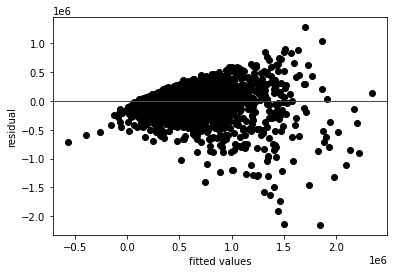

In [76]:
# Plot the residual plot of Away scores
plt.scatter(y_pred, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='red', linewidth=1)
plt.show()

In [77]:
from sklearn.model_selection import KFold

# lets run a k fold
folds = KFold(n_splits=10)

# note that if you have a KFold object, you can figure out how many folds you set up 
# for it using get_n_splits
print('we are using ' +str(folds.get_n_splits(X)) + ' folds')

# We now create and assess 5 models based on the folds we created.
RMSES = []
count = 1 
for train_index, test_index in folds.split(X):
  print('\nTraining model ' + str(count))
  
  # set up the train and test based on the split determined by KFold
  # With 5 folds, we will end up with 80% of our data in the training set, and 20% in the test set, just as above
  X_train, X_test = X.iloc[train_index], X.iloc[test_index]
  y_train, y_test = y.iloc[train_index], y.iloc[test_index]
  
  # fit a model accordingly
  regressor = LinearRegression()  
  regressor.fit(X_train, y_train)
  
  # assess the accuraccy of the model
  y_pred = regressor.predict(X_test)
  
  rmse_value =  np.sqrt(metrics.mean_squared_error(y_test, y_pred))
  RMSES.append(rmse_value)
  
  print('Model ' + str(count) + ' Root Mean Squared Error:',rmse_value)
  count = count + 1

we are using 10 folds

Training model 1
Model 1 Root Mean Squared Error: 236345.19731053695

Training model 2
Model 2 Root Mean Squared Error: 244488.49300223505

Training model 3
Model 3 Root Mean Squared Error: 220433.10393616278

Training model 4
Model 4 Root Mean Squared Error: 249815.9886260731

Training model 5
Model 5 Root Mean Squared Error: 214483.55113453616

Training model 6
Model 6 Root Mean Squared Error: 219286.05391397374

Training model 7
Model 7 Root Mean Squared Error: 217217.42019190735

Training model 8
Model 8 Root Mean Squared Error: 224177.23223363285

Training model 9
Model 9 Root Mean Squared Error: 228270.00952100928

Training model 10
Model 10 Root Mean Squared Error: 227593.74667662356


The lowest RMSE is in the 5th training model. 

In [78]:
residuals = np.subtract(y_pred, y_test)

# Let's describe our residual:
pd.DataFrame(residuals).describe()

residuals.mean()

9273.643502325867

### Bartlet's test 

In [79]:
import scipy as sp

test_result, p_value = sp.stats.bartlett(y_pred, residuals)

# To interpret the results we must also compute a critical value of the chi squared distribution
degree_of_freedom = len(y_pred)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)


if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')

the variances are homogeneous!


# Conclusion.

The analysis can be considered successfull as we were able to perform all the tests we had set out to achive at the beginning. The models have been developed and their accuracy and RMSEs stated after each prediction. 
The predictions (MSE) by each model are 
- Quantile -50268146104.904144
-Ridge - 50257288353.04845
-Lasso - 50268146104.904144
-Elastic net - 52834149320.86418
-Multiple Linener regression - 50268146104.904144

The model with the lowes MSE is that of ridge regression meaning that it would be the best model to use with the prediction of price

# Challenging the Solution


> It is possible to improve the models used above by trying other Regression types such as Polynomial Regression, KNN etc. Futhermore, the longitude and latitude information were not used in the prediction efficently. Therefore, the locations could not be determined and used as a predictor variable for the price. 

# Follow up questions

## a) Did we have the right data?


> Yes, the data was correct however, additional data of location and other factors could have made the prediction better. However, the accusacy score was above 60% hence it was good data 

## b) Do we need other data to answer our question?

> Other data like the proximity to minicipalities, road access would be very useful in predicting the house prices. 



## c) Did we have the right question?

> Yes, the prediction model for the price of the houses was the right question, considering the dataset and the Business objective of Hass consulting. 